In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error as mse
%matplotlib inline


from scipy.stats import norm
from scipy import stats

In [2]:
path = '../../../data/kc_house_data.csv'
df = pd.read_csv(path)
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000.0,3,2.50,1530,1131,3.0,0.0,0.0,...,8,1530,0.0,2009,0.0,98103,47.6993,-122.346,1530,1509
21593,6600060120,2/23/2015,400000.0,4,2.50,2310,5813,2.0,0.0,0.0,...,8,2310,0.0,2014,0.0,98146,47.5107,-122.362,1830,7200
21594,1523300141,6/23/2014,402101.0,2,0.75,1020,1350,2.0,0.0,0.0,...,7,1020,0.0,2009,0.0,98144,47.5944,-122.299,1020,2007
21595,291310100,1/16/2015,400000.0,3,2.50,1600,2388,2.0,NaN,0.0,...,8,1600,0.0,2004,0.0,98027,47.5345,-122.069,1410,1287


In [3]:
df['zipcode'].unique()

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039], dtype=int64)

In [4]:
df.corrwith(df["price"]).map(abs).sort_values(ascending=False)

price            1.000000
sqft_living      0.701917
grade            0.667951
sqft_above       0.605368
sqft_living15    0.585241
bathrooms        0.525906
view             0.395734
bedrooms         0.308787
lat              0.306692
waterfront       0.276295
floors           0.256804
yr_renovated     0.129599
sqft_lot         0.089876
sqft_lot15       0.082845
yr_built         0.053953
zipcode          0.053402
condition        0.036056
long             0.022036
id               0.016772
dtype: float64

In [5]:
df.corr()['sqft_living'].sort_values()

zipcode         -0.199802
condition       -0.059445
id              -0.012241
lat              0.052155
yr_renovated     0.055660
waterfront       0.110230
sqft_lot         0.173453
sqft_lot15       0.184342
long             0.241214
view             0.282532
yr_built         0.318152
floors           0.353953
bedrooms         0.578212
price            0.701917
bathrooms        0.755758
sqft_living15    0.756402
grade            0.762779
sqft_above       0.876448
sqft_living      1.000000
Name: sqft_living, dtype: float64

<AxesSubplot:xlabel='long', ylabel='lat'>

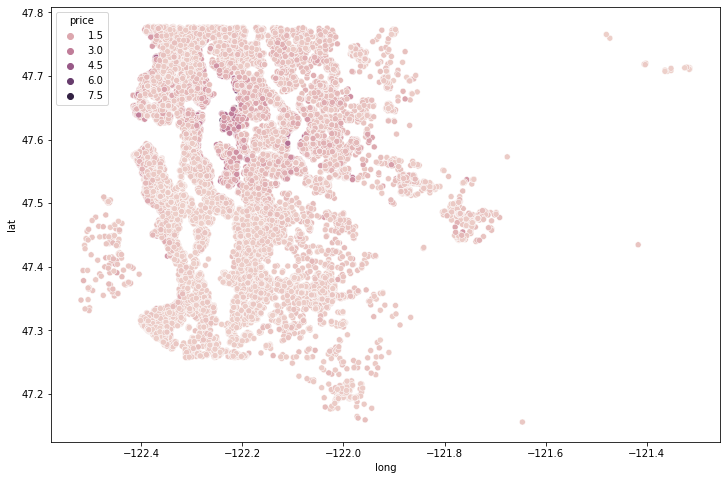

In [6]:
plt.figure(figsize=(12,8))
sns.scatterplot(x='long',y='lat',data=df,hue='price')

<AxesSubplot:xlabel='long', ylabel='lat'>

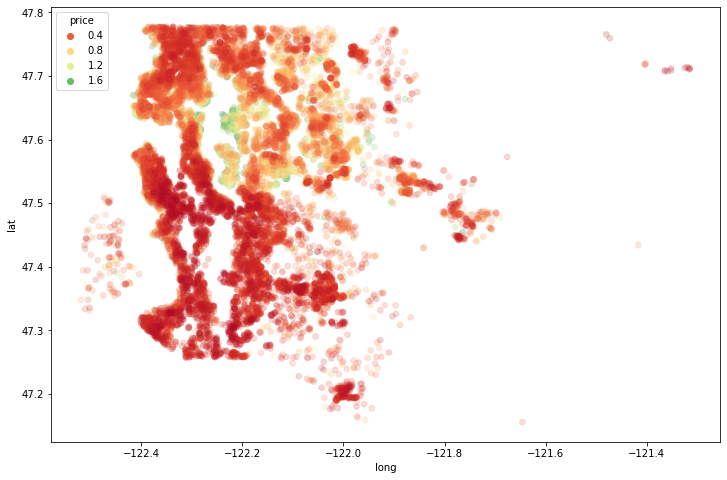

In [14]:
non_top_1_perc = df.sort_values('price',ascending=False).iloc[216:]
plt.figure(figsize=(12,8))
sns.scatterplot(x='long',y='lat',data=non_top_1_perc,
                edgecolor=None,alpha=0.2,palette='RdYlGn',hue='price')

In [15]:
print("Skewness: %f" % df['price'].skew())
print("Kurtosis: %f" % df['price'].kurt())

Skewness: 4.023365
Kurtosis: 34.541359


<AxesSubplot:xlabel='long', ylabel='lat'>

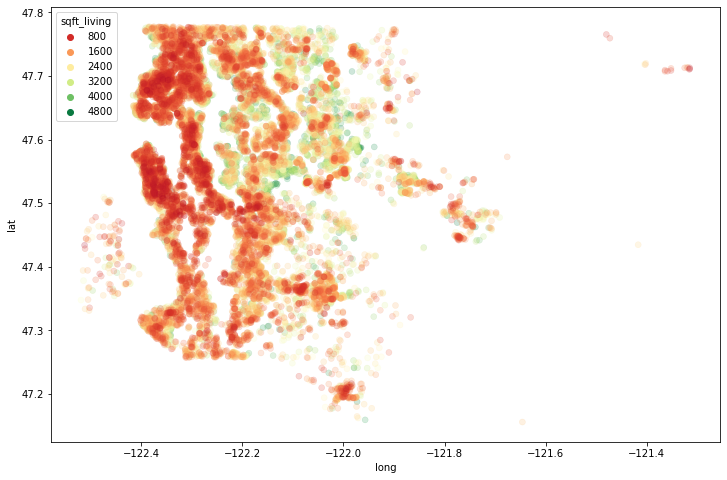

In [16]:
non_top_1_perc1 = df.sort_values('sqft_living',ascending=False).iloc[216:]
plt.figure(figsize=(12,8))
sns.scatterplot(x='long',y='lat',data=non_top_1_perc1,
                edgecolor=None,alpha=0.2,palette='RdYlGn',hue='sqft_living')

<AxesSubplot:xlabel='grade', ylabel='price'>

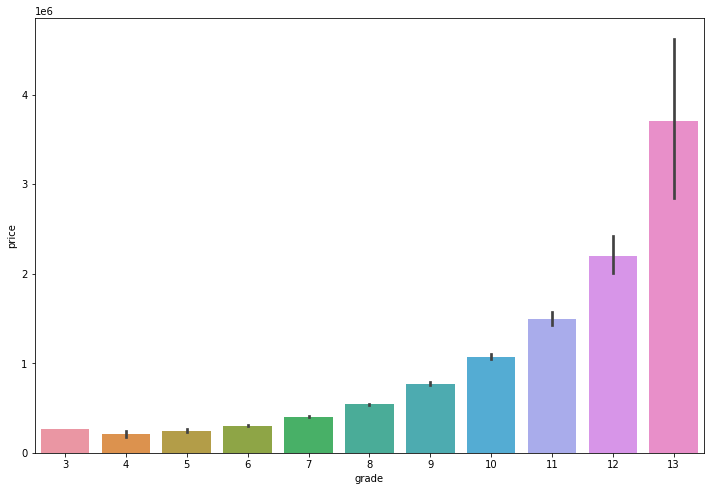

In [17]:
plt.figure(figsize=(12,8))
sns.barplot(x='grade',y='price',data=df)

C:\Users\kylev\anaconda3\envs\learn-env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


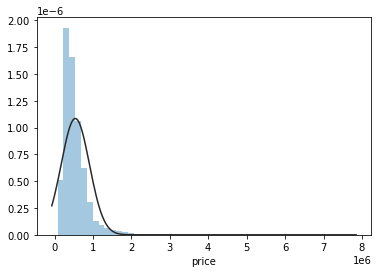

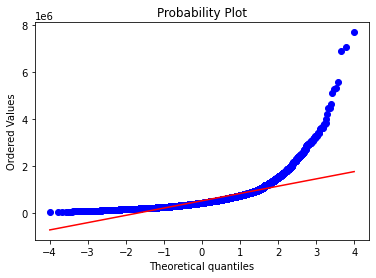

In [18]:
sns.distplot(df['price'], fit=norm, bins=50, kde=False);
fig = plt.figure()
res = stats.probplot(df['price'], plot=plt)

In [19]:


#applying log transformation
df['price'] = np.log(df['price'])



C:\Users\kylev\anaconda3\envs\learn-env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


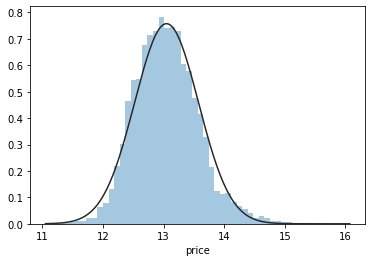

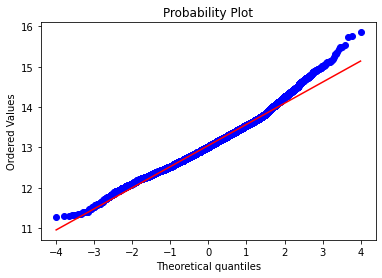

In [20]:
sns.distplot(df['price'], fit=norm, bins=50, kde=False);
fig = plt.figure()
res = stats.probplot(df['price'], plot=plt)

C:\Users\kylev\anaconda3\envs\learn-env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


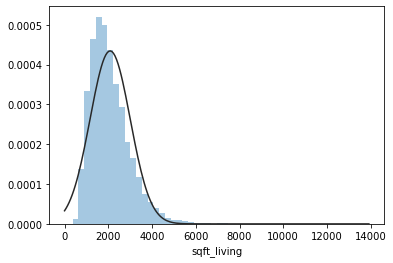

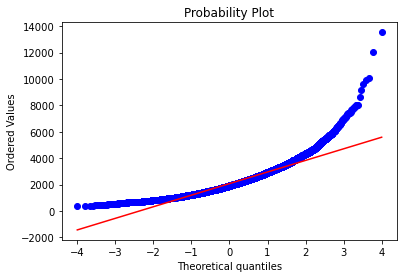

In [14]:
sns.distplot(df['sqft_living'], fit=norm, bins=50, kde=False);
fig = plt.figure()
res = stats.probplot(df['sqft_living'], plot=plt)

In [15]:
df['sqft_living'] = np.log(df['sqft_living'])

C:\Users\kylev\anaconda3\envs\learn-env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


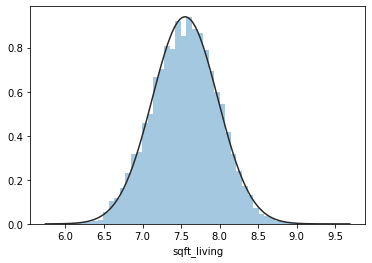

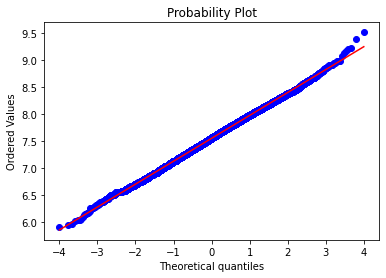

In [16]:
sns.distplot(df['sqft_living'], fit=norm, bins=50, kde=False);
fig = plt.figure()
res = stats.probplot(df['sqft_living'], plot=plt)

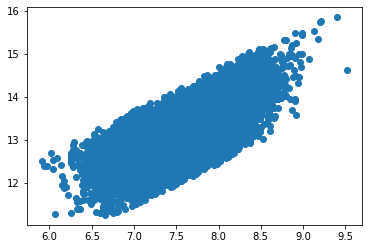

In [17]:


#scatter plot
plt.scatter(df['sqft_living'], df['price']);



In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  float64
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [19]:
df.drop('date', axis=1, inplace=True)

In [20]:
df.fillna(df.mean(), inplace=True)

In [21]:
df.loc[df['sqft_basement'].isin(['?'])] = '0'

In [22]:
df1 = df.drop('price',axis=1)

In [39]:
X = df1
y = df['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [24]:
X_train

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
6405,3905080280,3,2.5,7.53903,4499,2,0,0,3,8,1880,0.0,1993,0,98029,47.5664,-121.999,2130,5114
937,5466420030,3,2.5,7.61085,6564,1,0,0,3,7,1310,710.0,1994,0,98042,47.3545,-122.158,1710,5151
19076,2623069010,5,4,8.45956,493534,2,0,0,5,9,3960,760.0,1975,0,98027,47.4536,-122.009,2160,219542
15201,4443800545,2,2,7.26543,3880,1,0,0,4,7,1430,0.0,1949,0,98117,47.6844,-122.392,1430,3880
13083,9485930120,3,2.25,7.72754,32112,1,0,0,4,8,1740,530.0,1980,0,98042,47.3451,-122.094,2310,41606
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11964,7853230570,3,2.5,7.70976,5800,2,0,0,3,7,2230,0.0,2004,0,98065,47.5308,-121.847,2230,6088
21575,4140940150,4,2.75,7.9266,3852,2,0,0,3,8,2770,0.0,2014,83.6368,98178,47.5001,-122.232,1810,5641
5390,8658300480,4,1.5,7.33302,9000,1,0,0,4,6,1530,0.0,1976,0,98014,47.6492,-121.908,1520,8500
860,1723049033,1,0.75,5.94017,15000,1,0,0,3,5,380,0.0,1963,0,98168,47.481,-122.323,1170,15000


In [25]:


# Instantiate imputer object
imputer = SimpleImputer()



In [26]:
# Fit and transform training data
X_train_imputed = imputer.fit_transform(X_train)

# Transform testing data
X_test_imputed = imputer.transform(X_test)# Fit and transform training data


In [27]:
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [28]:


print('Intercept: {}'.format(lr.intercept_))
print('Slope: {}'.format(lr.coef_))



Intercept: [-8.12575613e-05]
Slope: [[ 3.96533226e-13 -2.56393813e-02  6.46506135e-02  2.26601402e-01
   4.70262360e-07  7.38402330e-02  4.17769681e-01  6.21513255e-02
   6.00959973e-02  1.59057312e-01  5.32973002e-05  5.98866236e-05
  -3.74633475e-03  3.61931526e-05 -7.06877861e-04  1.38769797e+00
  -1.64791559e-01  9.52678191e-05 -3.30912232e-07]]


In [29]:
train_preds = lr.predict(X_train)
test_preds = lr.predict(X_test)

In [30]:
train_score = (mean_squared_error(y_train, train_preds))**.5
test_score = (mean_squared_error(y_test, test_preds))**.5


NameError: name 'mean_squared_error' is not defined

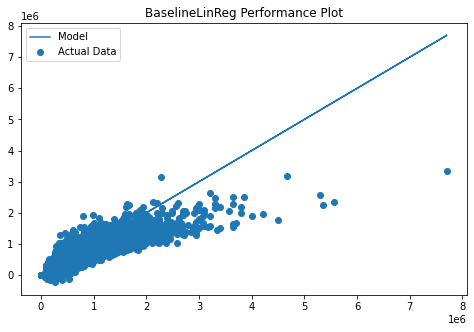

In [78]:
plt.figure(figsize=(8, 5))
plt.scatter(y_train, train_preds, label='Actual Data')
plt.plot(y_train, y_train, label='Model')
plt.title('BaselineLinReg Performance Plot')
plt.legend();

In [40]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
# fit the model
model = RandomForestRegressor(random_state=1)
model.fit(X_train, y_train)
# make predictions
yhat = model.predict(X_test)
# evaluate predictions
mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

MAE: 0.122
